# Load Modules
- This code is created by Dartbrain Tutorials : Preprocessing & ISFC 

In [45]:
%matplotlib inline

import os
import glob
import numpy as np
from numpy.fft import fft, ifft, fftfreq
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.animation import FuncAnimation
import seaborn as sns
from nltools.data import Brain_Data, Adjacency
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import isc, isfc, isps, fdr, threshold, phase_randomize, circle_shift, _butter_bandpass_filter, _phase_mean_angle, _phase_vector_length
from nilearn.plotting import view_img_on_surf, view_img
from sklearn.metrics import pairwise_distances
from sklearn.utils import check_random_state
from scipy.stats import ttest_1samp
from scipy.signal import hilbert
#import networkx as nx
from IPython.display import HTML
from tqdm import tqdm

# import nest_asyncio
# nest_asyncio.apply()
import datalad.api as dl

base_dir = '/mnt/c/Users/since/Desktop/KdramaSpring/'
data_dir = '/mnt/c/Users/since/Desktop/KdramaSpring/data/derivatives/'
denoised_dir = os.path.join(base_dir, 'analysis', 'denoised')
Zdenoised_dir = os.path.join(base_dir, 'analysis', 'denoised_zscore')
ROIs_dir = os.path.join(base_dir, 'analysis', 'denoised_zscore', 'Averaged_ROI')
#mask = Brain_Data(os.path.join(base_dir,'analysis', 'Masks', 'k50_2mm.nii.gz'))

# Parcellation (n=50)
- This code is referenced from the Dartbrain: preprocessong 
- You can learn about the parcellation in the Dartbrain : https://dartbrains.org/content/Parcellations.html

In [327]:
##### Finally, we have also precomputed average activations within a whole brain parcellation (n=50) for some of the tutorials.

#data_dir = '/Volumes/Engram/Data/Sherlock/fmriprep'

#mask = Brain_Data('http://neurovault.org/media/images/2099/Neurosynth%20Parcellation_0.nii.gz')
mask = Brain_Data(os.path.join(base_dir, 'analysis','Masks', 'k50_2mm.nii.gz'))
subjects = ['01', '02', '03', '04', '05', '06', '08']
for s in tqdm(subjects):
    file_list = glob.glob(os.path.join(Zdenoised_dir, f'sub-{s}_denoise_task-encoding_*.hdf5')) # task-encoding 에 대해서만 분석 
    #print(len(file_list))
    for f in file_list:
        print(f)
        sub = os.path.basename(f).split('_')[0]
        run = os.path.basename(f).split('_')[3]
        #print(sub, run)
        data = Brain_Data(f) 
        roi = data.extract_roi(mask)
        pd.DataFrame(roi.T).to_csv(os.path.join(os.path.dirname(f), 'Averaged_ROI', f"{sub}_{run}_Average_ROI_n50.csv" ), index=False)

  0%|                                                                                             | 0/7 [00:00<?, ?it/s]

/mnt/c/Users/since/Desktop/KdramaSpring/analysis/denoised_zscore/sub-01_denoise_task-encoding_run-1_space-MNI152NLin6Asym_desc-preproc_bold.hdf5


/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/masking.py:858: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)
  0%|                                                                                             | 0/7 [00:06<?, ?it/s]
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1120: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/home/sincerely/.conda/envs/ISC/

KeyboardInterrupt: 

## 질문 1. Neurosynth%20Parcellation 에서 여러개가 있는데... 어떤 ROI mask를 쓰는 게 맞나요? 
- 내가 사용한 ROI Mask : https://neurovault.org/images/395092/

In [358]:
rois = pd.read_csv('https://raw.githubusercontent.com/naturalistic-data-analysis/tutorial_development/master/hypertools/rois.csv', header=None, names=['ID', 'Region'])
print(rois.shape)
rois

(41, 2)


,ID,Region
0,0,Anterior MPFC
1,1,Fusiform/parahippocampus
2,2,DMPFC
3,3,Sensorimotor/postcentral gyrus
4,4,V1
5,5,TPJ posterior supra marginal/angular gyrus
6,6,PCC/precuneus
7,7,Thalamus
8,8,SMA
9,9,Precentral gyrus


# Intra subject correlation

In [324]:
sub_timeseries = {}
subjects = [ '02', '03', '04', '05', '06']
for sub in subjects:
    run_timeseries = {}
    for run in ['run-1', 'run-2']:
        run_data = pd.read_csv(os.path.join(ROIs_dir, f'sub-{sub}_{run}_Average_ROI_n50.csv'))
        run_data.reset_index(inplace=True, drop=True)
        run_timeseries[run] = run_data
    sub_timeseries[sub] = run_timeseries

In [376]:
sub_isc_r, sub_isc_p = {}, {}
isc_r_brain, isc_p_brain = {}, {}
def get_subject_roi(data, roi):
    run_rois = {}
    for run in ['run-1', 'run-2']:
        run_rois[run] = data[run].iloc[:, roi]
    return pd.DataFrame(run_rois)

#mask = Brain_Data(os.path.join(base_dir, 'analysis','Masks', 'k50_2mm.nii.gz'))
mask = Brain_Data('http://neurovault.org/media/images/2099/Neurosynth%20Parcellation_0.nii.gz')
mask_x = expand_mask(mask)

subjects = [ '02', '03', '04', '05', '06']
for sub in subjects:
    isc_r, isc_p = {}, {} 
    for roi in tqdm(range(50)):
        stats = isc(get_subject_roi(sub_timeseries[sub], roi), n_bootstraps=5000, metric='median', method='bootstrap')
        isc_r[roi], isc_p[roi] = stats['isc'], stats['p']
    sub_isc_r[sub], sub_isc_p[sub] = isc_r, isc_p
    isc_r_brain[sub], isc_p_brain[sub] = roi_to_brain(pd.Series(isc_r), mask_x), roi_to_brain(pd.Series(isc_p), mask_x)

100%|███████████████████████████████████████████████████████████████████████████████████| 50/50 [00:28<00:00,  1.74it/s]


/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



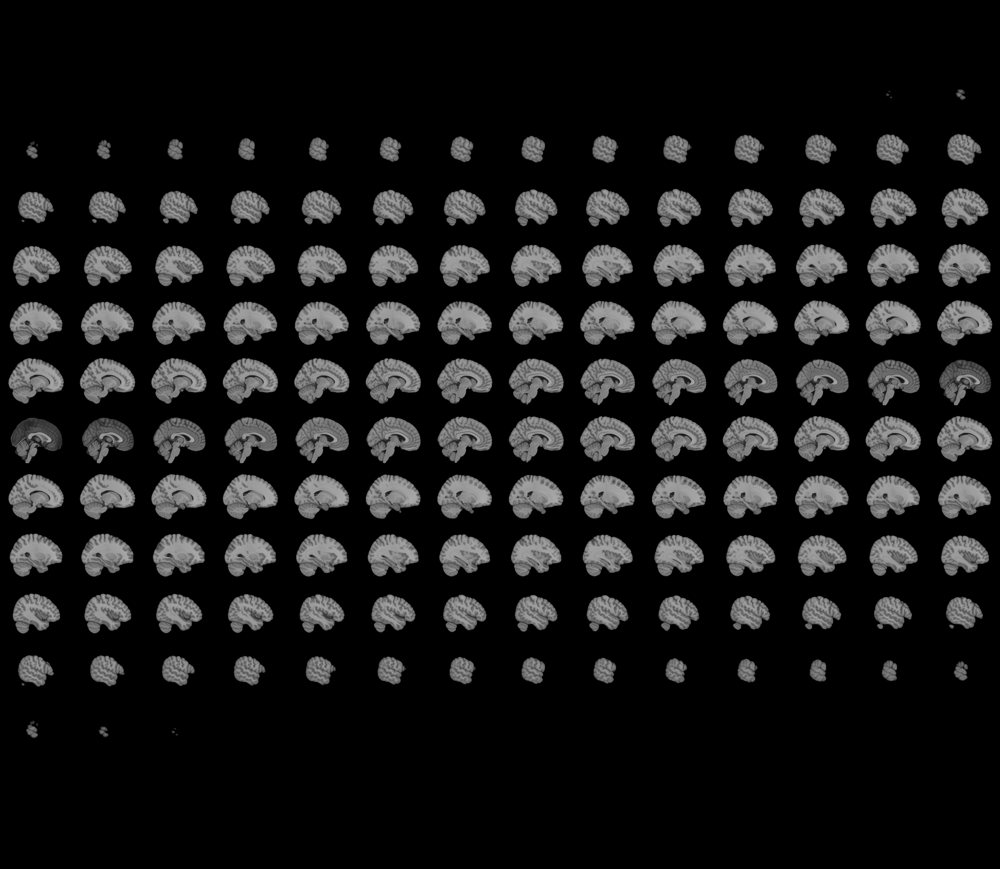
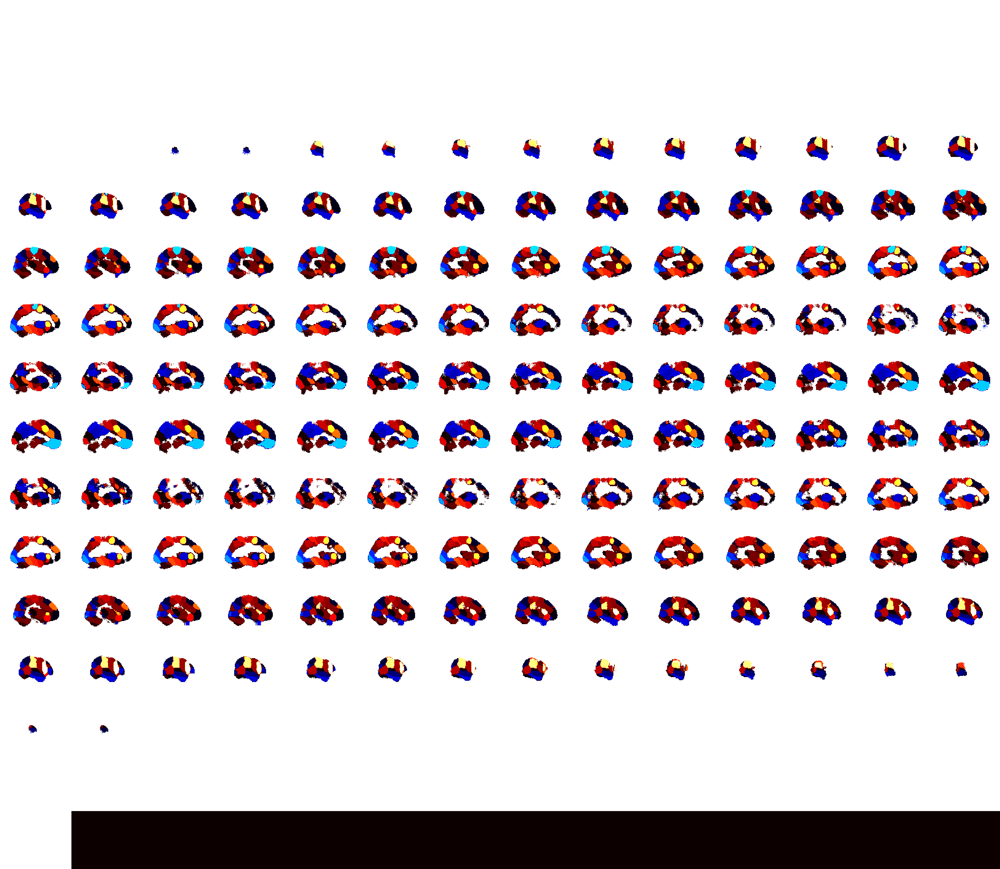

In [378]:
view_img(isc_r_brain['02'].to_nifti())

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



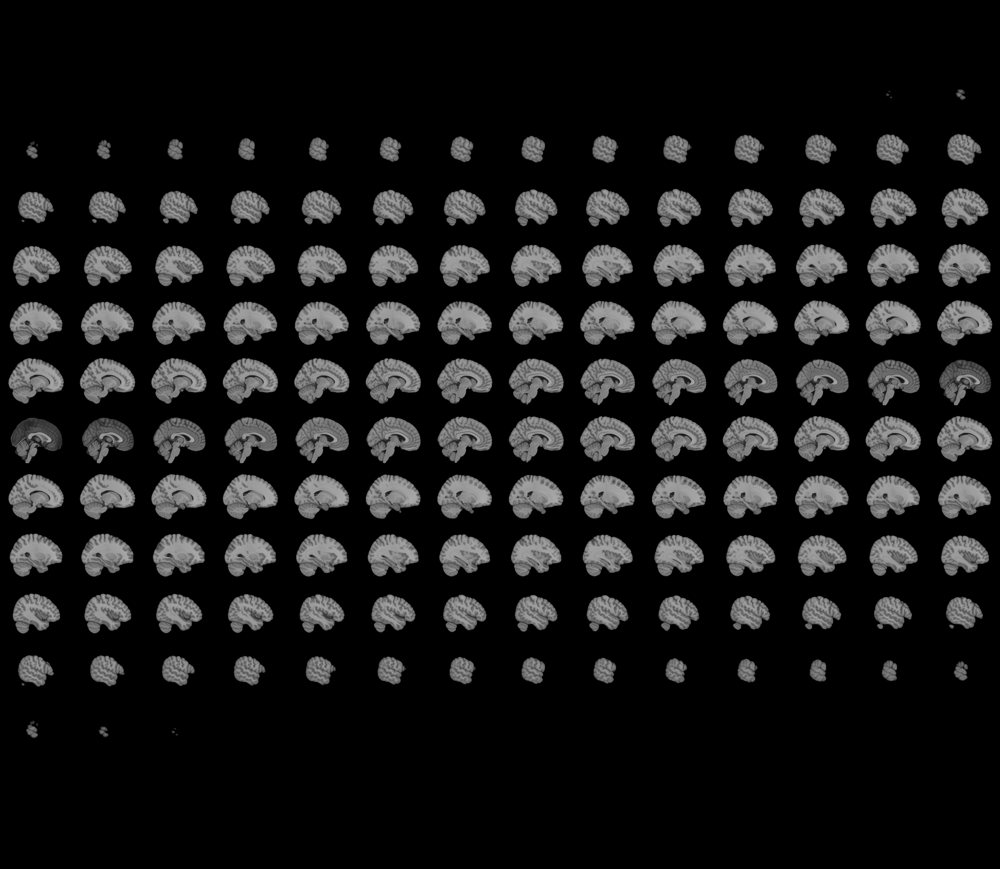
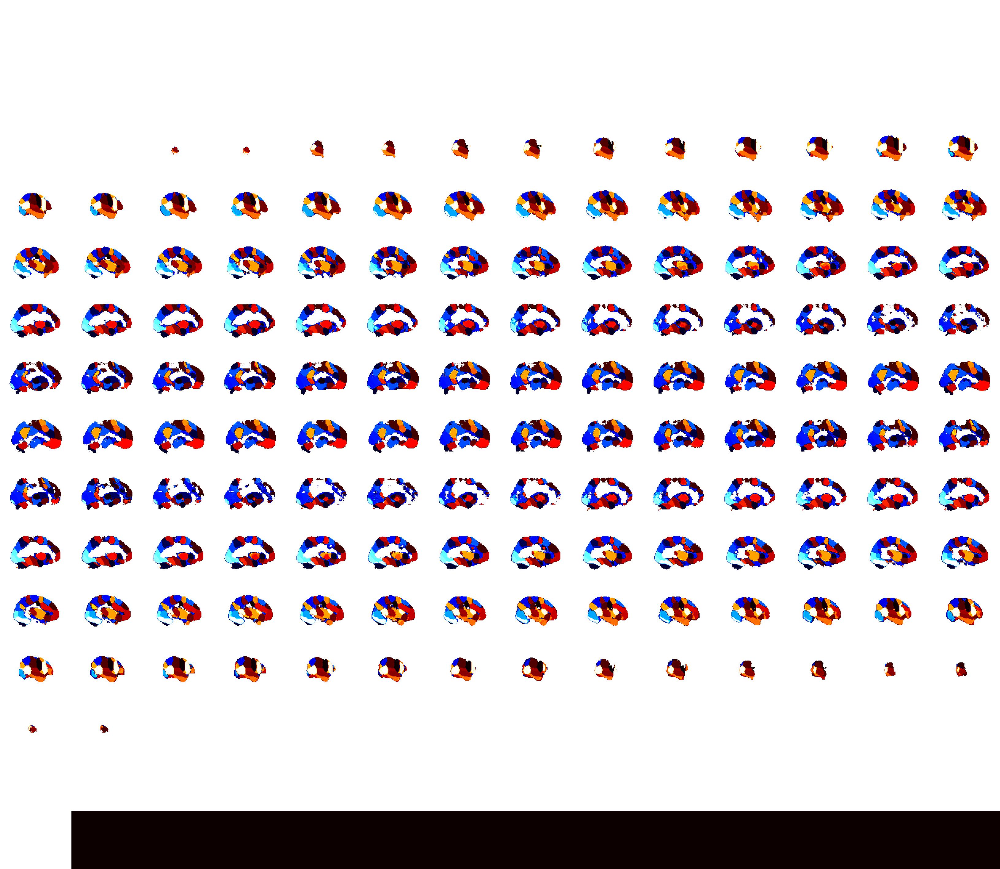

In [148]:
view_img(isc_r_brain['03'].to_nifti())

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/masking.py:858: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/plotting/html_document.py:63: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



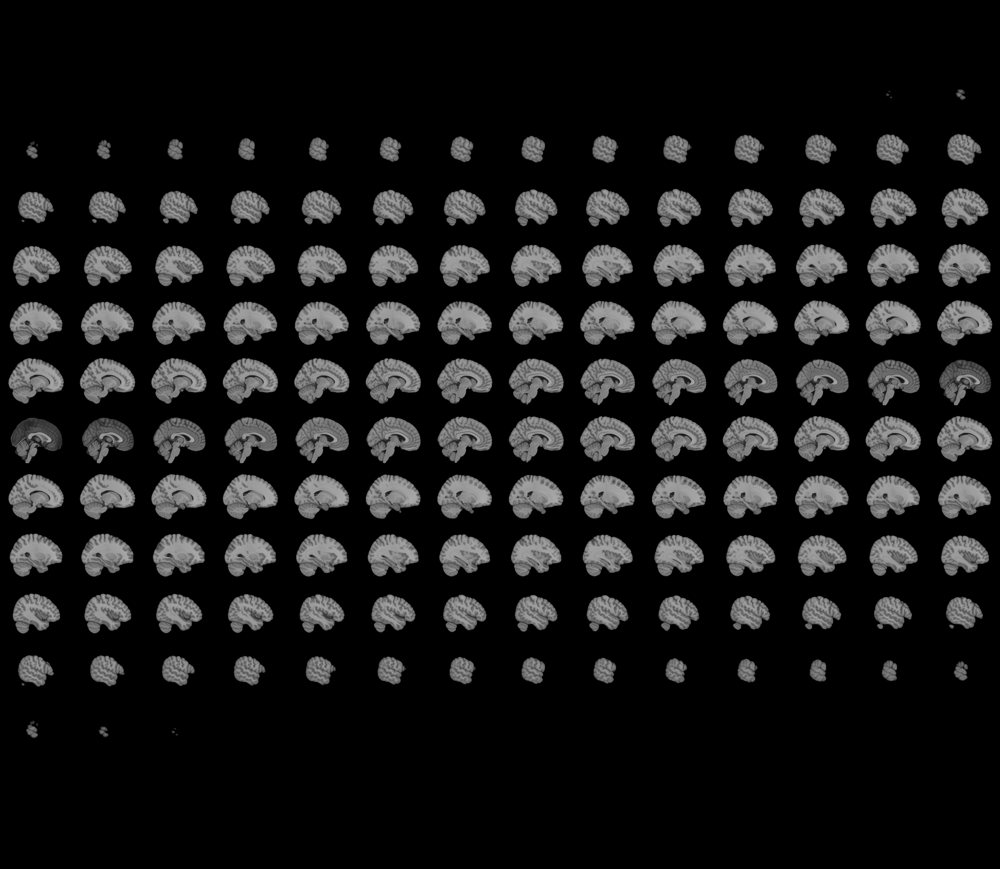
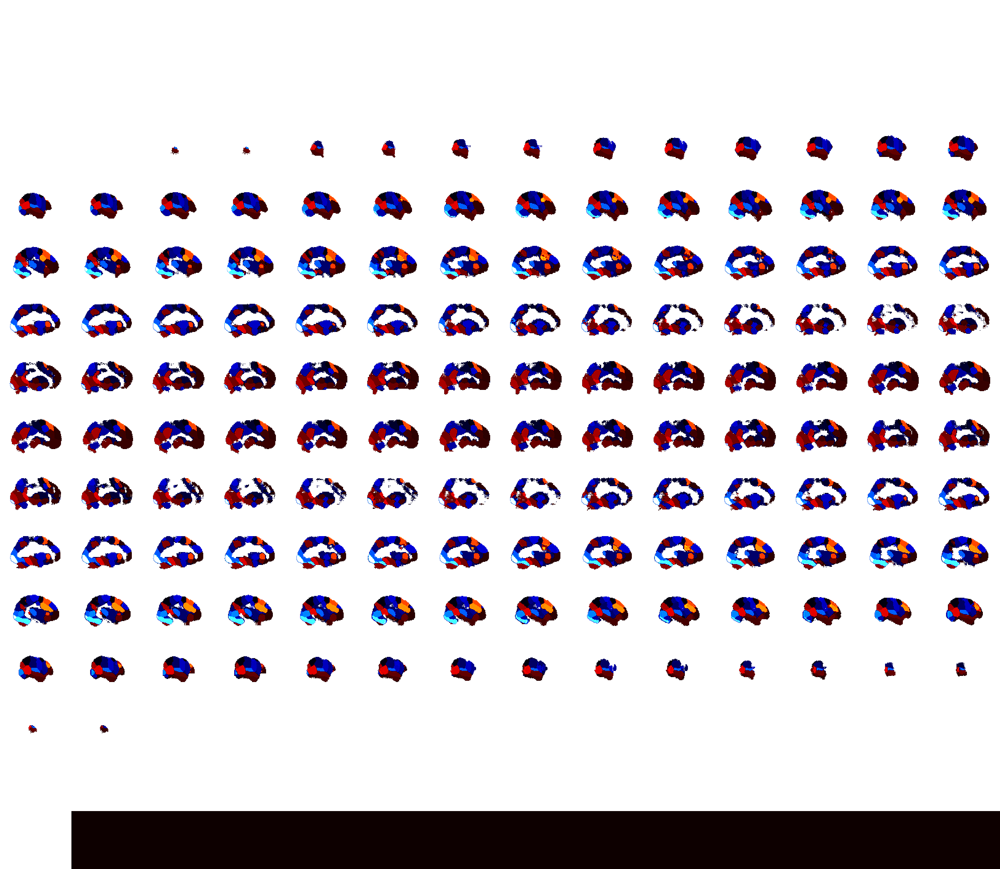

In [160]:
view_img(threshold(isc_r_brain['04'], isc_p_brain['04'], thr=.001).to_nifti())

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



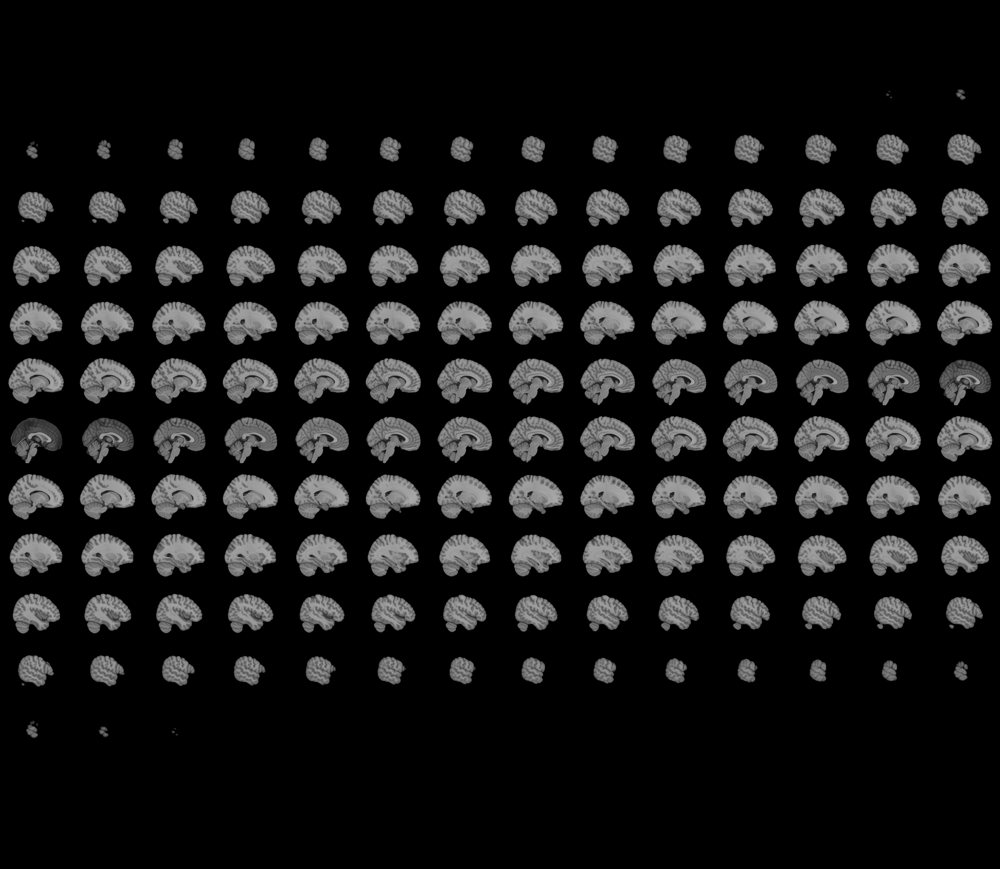
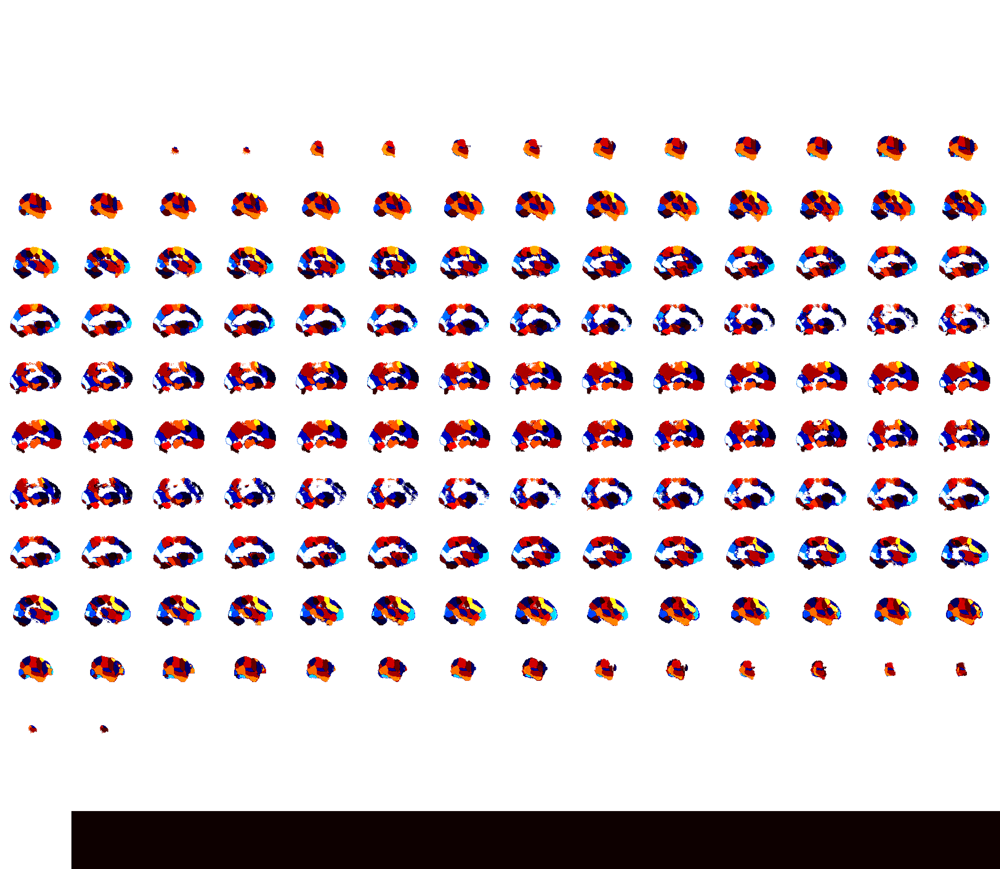

In [379]:
view_img(isc_r_brain['05'].to_nifti())

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



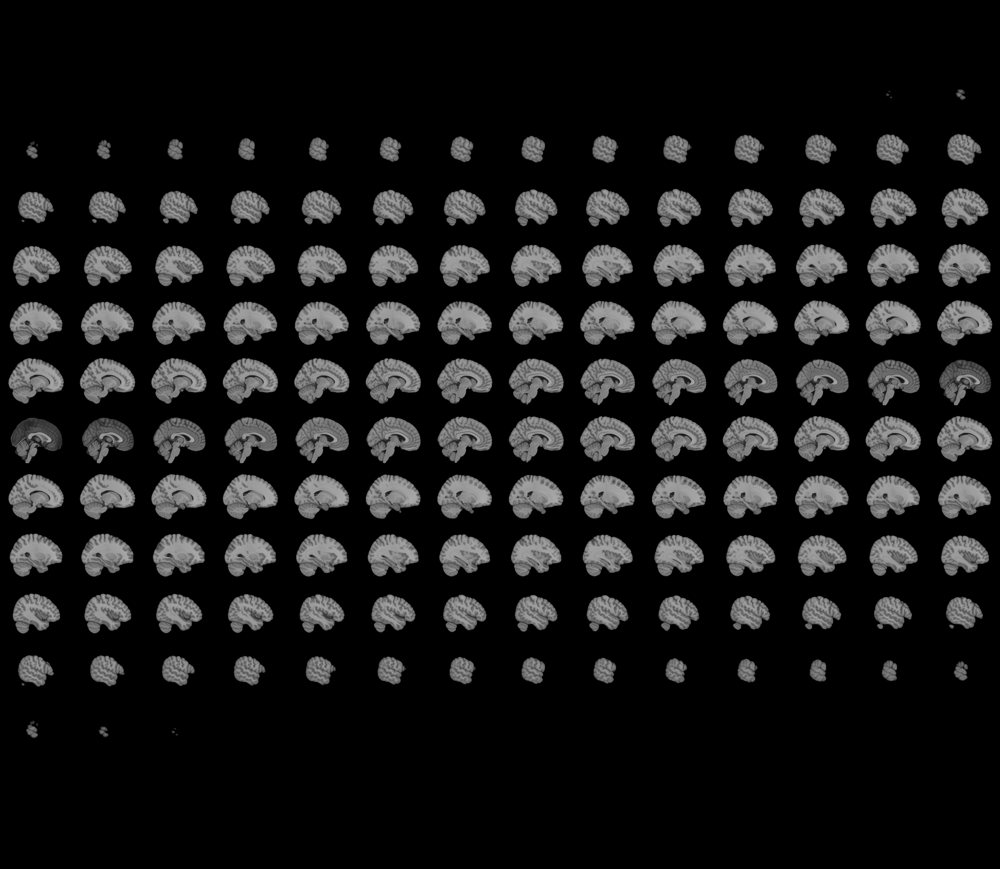
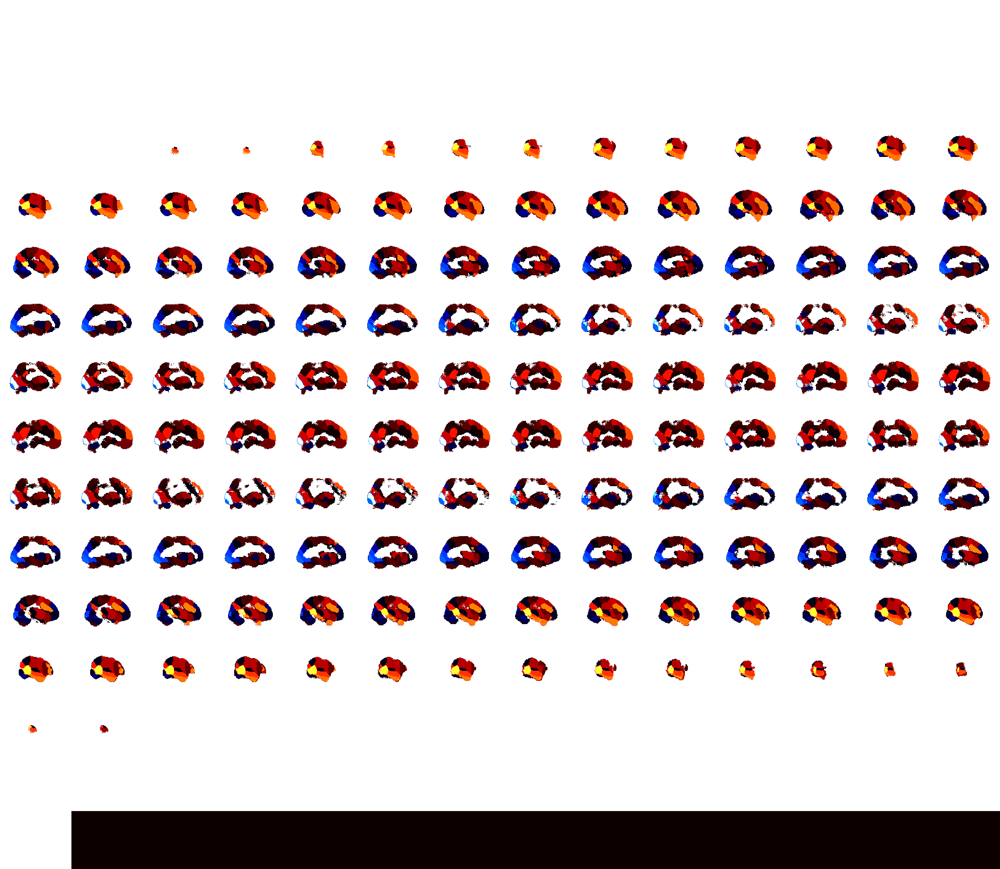

In [380]:
view_img(isc_r_brain['06'].to_nifti())

In [381]:
from scipy import stats

sub_zisc = {}
subjects = [ '02', '03', '04', '05', '06']
for sub in subjects:
    a = []
    for roi in np.arange(50):
        a = np.append(a, sub_isc_r[sub][roi])
    zisc = stats.zscore(a)
    sub_zisc[sub] = zisc

    
mean_z1 = (sub_zisc['02'] + sub_zisc['03']+ sub_zisc['04']) /3
mean_z2 = (sub_zisc['05']  +sub_zisc['06'])/2
mean_cont = mean_z2 - mean_z1

In [384]:
print(mean_z1)
print(mean_z2)
#print(mean_cont)
df = pd.DataFrame(mean_cont)
df.columns = {'rois'}

print('rois < 0', df.loc[df['rois'] < 0]) 
print('rois > 0', df.loc[df['rois'] > 0])

[ 0.46519963  1.0544      0.02018762 -0.13416723  0.22303317  1.30171047
 -0.92473691 -0.09513604  0.22051938  1.37779004  0.04325352 -1.56271914
 -0.05842075  0.10405255 -0.3763227   0.66415064  0.4003806  -0.32768546
  1.13558506  0.45151458 -1.60519583 -0.58383279  0.70861792  0.06297655
 -0.15718886  0.20998527 -1.08361637  1.00690649  0.65226836 -0.42907889
  0.88642851 -0.7155773  -0.27927693 -0.37009224  0.14784094 -0.42971004
  0.3503197   0.53437744 -0.41462867  0.03075316  0.57590914  0.16824746
  0.31877552 -2.35135698  0.14986185  0.1293161  -1.36155281 -0.41123087
  0.09633872  0.18082639]
[-6.29221244e-01  4.07433071e-01  5.43475962e-01  3.79631789e-01
 -3.34303568e+00  1.83566277e+00  1.29052976e-01  4.50432395e-01
  5.85517552e-01 -2.18502435e-01  5.81910558e-02 -5.05134802e-01
 -2.75822869e-01  8.16361958e-01 -5.51935874e-01  5.84811651e-01
  5.43863595e-01 -3.70339841e-01  1.75758273e-01  7.44545747e-01
 -2.35818217e+00  1.74681924e-01 -2.59241851e-01 -1.32227368e-01


/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/plotting/html_document.py:63: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



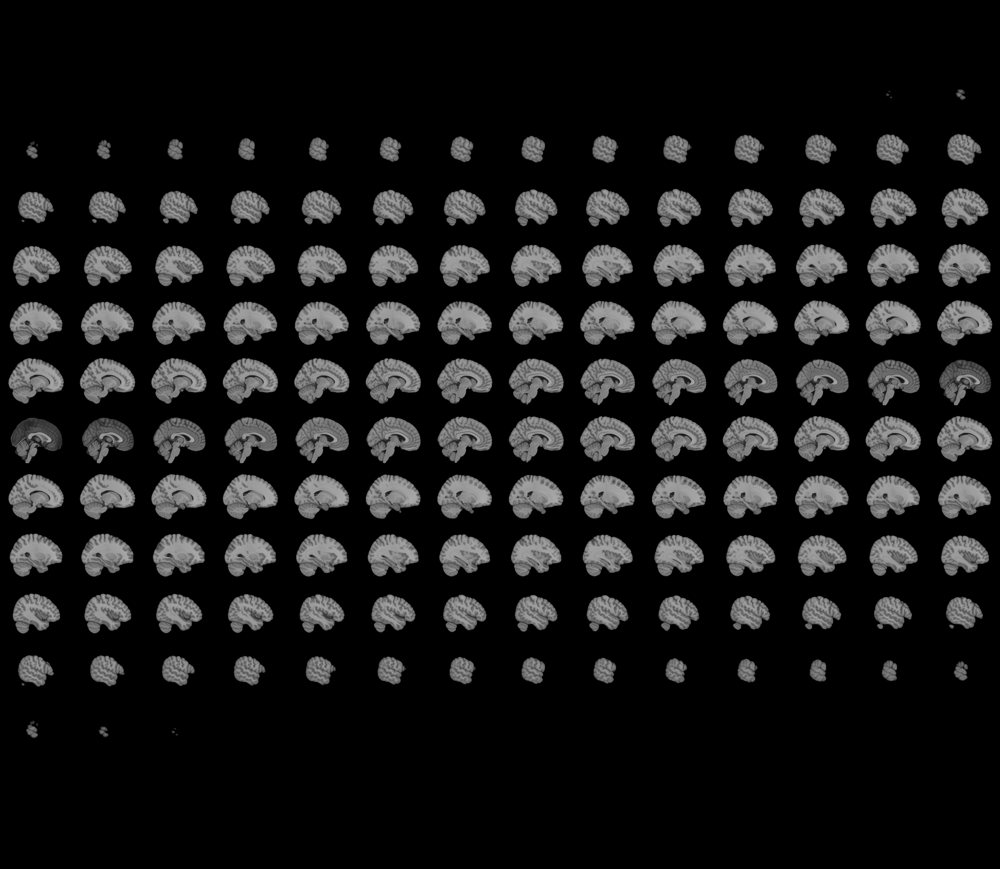
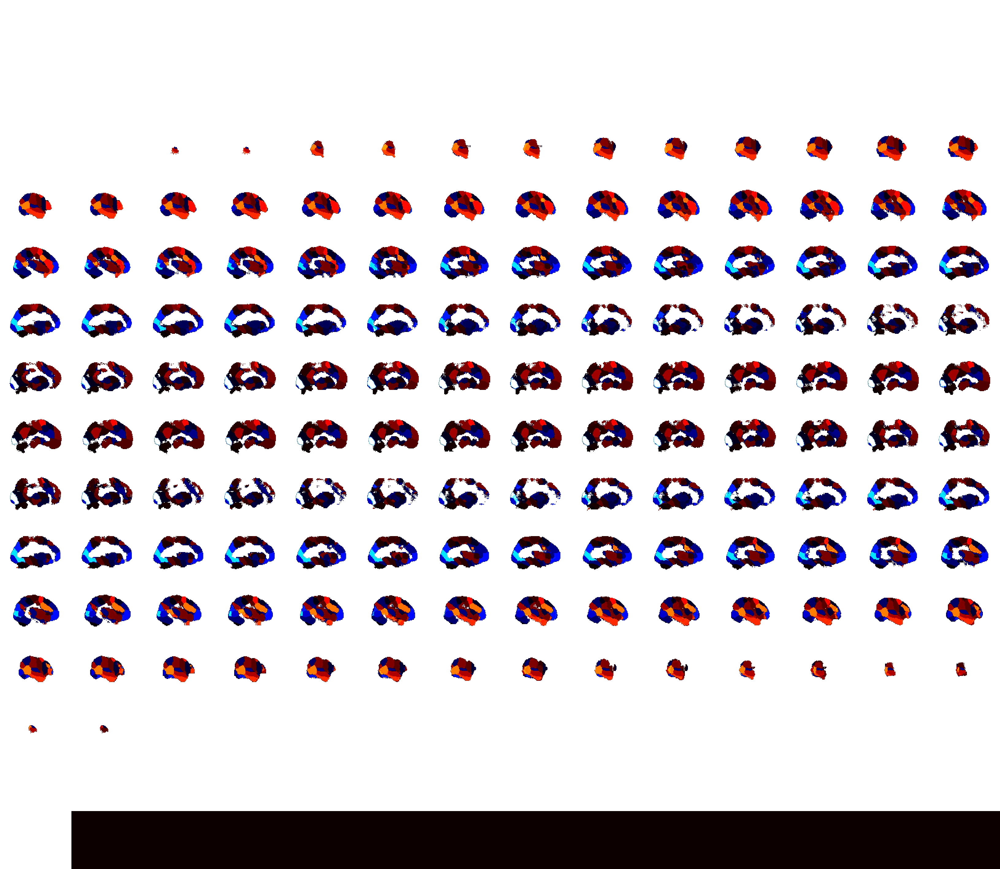

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1120: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1120: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed 

In [386]:
mean2_img = roi_to_brain(pd.Series(mean_z2), mask_x)
mean1_img = roi_to_brain(pd.Series(mean_z1), mask_x)
mean_cont_img = roi_to_brain(pd.Series(mean_cont), mask_x)
view_img(mean2_img.to_nifti())

In [391]:
cd /mnt/c/Users/since/Desktop/KdramaSpring/analysis/ISC

/mnt/c/Users/since/Desktop/KdramaSpring/analysis/ISC


In [392]:
#save the img
mean2_img.write('S05-6_avg_ISC_04122023_bold.nii.gz')

# ISFC

To specifically address how brain regions coactivate due to naturalistic stimulation, ISC was recently extended to intersubject functional connectivity (ISFC) to measure brain connectivity between runs. ISFC can illustrate how distant brain regions cooperate to make sense of the incoming stimulus streams. However, it can also highlight pairs of regions that show similar temporal activity patterns that are driven by the external stimulus rather than neural connections between the regions.

## Intra Subject FC : Compare between runs

In [4]:
sub_timeseries = {}
subjects = [ '02', '03', '04', '05', '06']
for sub in subjects:
    run_timeseries = {}
    for run in ['run-1', 'run-2']:
        run_data = pd.read_csv(os.path.join(ROIs_dir, f'sub-{sub}_{run}_Average_ROI_n50.csv'))
        run_data.reset_index(inplace=True, drop=True)
        run_timeseries[run] = run_data
    sub_timeseries[sub] = run_timeseries

([<matplotlib.axis.YTick at 0x7efbea734fd0>,
 [Text(0, 0, '0'),
  Text(0, 5, '5'),
  Text(0, 10, '10'),
  Text(0, 15, '15'),
  Text(0, 20, '20'),
  Text(0, 25, '25'),
  Text(0, 30, '30'),
  Text(0, 35, '35'),
  Text(0, 40, '40'),
  Text(0, 45, '45'),
  Text(0, 50, '50')])

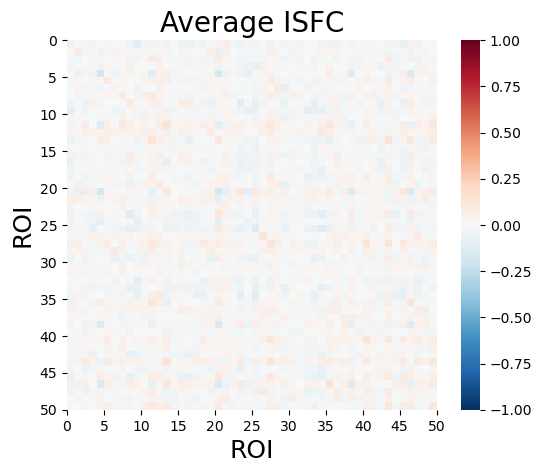

In [400]:
data = list(sub_timeseries['05'].values()) # S02 의 Run 1과 Run2 각각에서 50 개의 ROI

isfc_output = isfc(data)
x = np.arange(0,51,5) 

sns.heatmap(np.array(isfc_output).mean(axis=0), vmin=-1, vmax=1, square=True, cmap='RdBu_r', xticklabels=False, yticklabels=False)
plt.title('Average ISFC', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)
plt.xticks(x,x)
plt.yticks(x,x)

# Brainiak : Seed-based connectivity : FC and ISFC

In [297]:
# Load in the data 
import nibabel as nib
# Get the nifti object : Load the preprocessed data for subject 1
nii1 = nib.load(glob.glob(os.path.join(Zdenoised_dir , 'sub-05_denoise_task-encoding_run-1_space-MNI152NLin6Asym_desc-preproc_bold.nii.gz'))[0])
nii2 = nib.load(glob.glob(os.path.join(Zdenoised_dir , 'sub-05_denoise_task-encoding_run-2_space-MNI152NLin6Asym_desc-preproc_bold.nii.gz'))[0])


In [298]:
from nilearn import input_data
# Init a masker object that also standardizes the data
masker_wb = input_data.NiftiMasker(
    standardize=True,  # Are you going to zscore the data across time?
    t_r=1.5, 
    memory='nilearn_cache',  # Caches the mask in the directory given as a string here so that it is easier to load and retrieve
    memory_level=1,  # How much memory will you cache?
    verbose=0
    
)

# Pull out the time course for voxel & Fitting the mask to whole brain
bold_wb1 = masker_wb.fit_transform(nii1)
bold_wb2 = masker_wb.fit_transform(nii2)
print('shape - whole brain bold time series of run-1: ', np.shape(bold_wb1))
print('shape - whole brain bold time series of run-2: ', np.shape(bold_wb1))

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/maskers/nifti_masker.py:589: UserWarning: Persisting input arguments took 2.21s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  dtype=self.dtype,
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/maskers/nifti_masker.py:589: UserWarning: Persisting input arguments took 2.20s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the pro

shape - whole brain bold time series of run-1:  (604, 236277)
shape - whole brain bold time series of run-2:  (604, 236277)


### Creating a seed from an altas 

#### Oxford Atlas parcellation

{'filename': '/home/sincerely/nilearn_data/fsl/data/atlases/HarvardOxford/HarvardOxford-cort-maxprob-thr25-2mm.nii.gz', 'maps': <nibabel.nifti1.Nifti1Image object at 0x7efbee782950>, 'labels': ['Background', 'Frontal Pole', 'Insular Cortex', 'Superior Frontal Gyrus', 'Middle Frontal Gyrus', 'Inferior Frontal Gyrus, pars triangularis', 'Inferior Frontal Gyrus, pars opercularis', 'Precentral Gyrus', 'Temporal Pole', 'Superior Temporal Gyrus, anterior division', 'Superior Temporal Gyrus, posterior division', 'Middle Temporal Gyrus, anterior division', 'Middle Temporal Gyrus, posterior division', 'Middle Temporal Gyrus, temporooccipital part', 'Inferior Temporal Gyrus, anterior division', 'Inferior Temporal Gyrus, posterior division', 'Inferior Temporal Gyrus, temporooccipital part', 'Postcentral Gyrus', 'Superior Parietal Lobule', 'Supramarginal Gyrus, anterior division', 'Supramarginal Gyrus, posterior division', 'Angular Gyrus', 'Lateral Occipital Cortex, superior division', 'Lateral Oc

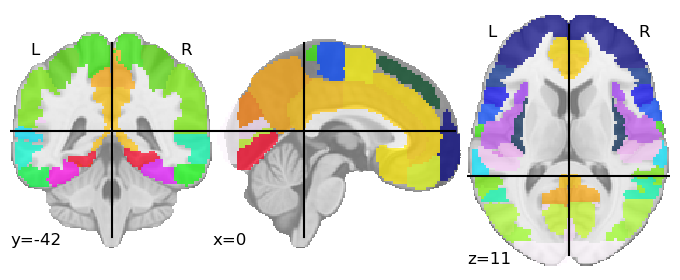

In [287]:
#havard_oxford atlas
from nilearn import datasets
from nilearn import plotting
atlas = datasets.fetch_atlas_harvard_oxford('cort-maxprob-thr25-2mm')
atlas_filename = atlas.maps
print(atlas)
# This is where the atlas is saved.
#print("Atlas path: " + f'{atlas_filename}' + "\n\n")

# Plot the ROIs
plotting.plot_roi(atlas_filename);
print('Harvard-Oxford cortical atlas')

In [408]:
pd.DataFrame(atlas.labels)

,0
0,Background
1,Frontal Pole
2,Insular Cortex
3,Superior Frontal Gyrus
4,Middle Frontal Gyrus
5,"Inferior Frontal Gyrus, pars triangularis"
6,"Inferior Frontal Gyrus, pars opercularis"
7,Precentral Gyrus
8,Temporal Pole
9,"Superior Temporal Gyrus, anterior division"


In [299]:
from nilearn.input_data import NiftiMasker, NiftiLabelsMasker

# Create a masker object that we can use to select ROIs
masker_ho = NiftiLabelsMasker(labels_img=atlas_filename)
print(masker_ho.get_params())

# Apply our atlas to the Nifti object so we can pull out data from single parcels/ROIs
bold_ho1 = masker_ho.fit_transform(nii1)
bold_ho2 = masker_ho.fit_transform(nii2)

print('shape: parcellated bold time courses: ', np.shape(bold_ho1))
print('shape: parcellated bold time courses: ', np.shape(bold_ho2))

{'background_label': 0, 'detrend': False, 'dtype': None, 'high_pass': None, 'high_variance_confounds': False, 'labels': None, 'labels_img': <nibabel.nifti1.Nifti1Image object at 0x7efbee782950>, 'low_pass': None, 'mask_img': None, 'memory': Memory(location=None), 'memory_level': 1, 'reports': True, 'resampling_target': 'data', 'smoothing_fwhm': None, 'standardize': False, 'standardize_confounds': True, 'strategy': 'mean', 't_r': None, 'verbose': 0}
shape: parcellated bold time courses:  (604, 48)
shape: parcellated bold time courses:  (604, 48)


Parcellated data shape (time points x num ROIs)
All time points   (604, 48)
Posterior PCC (region 34) whole tirals:  (604, 1)


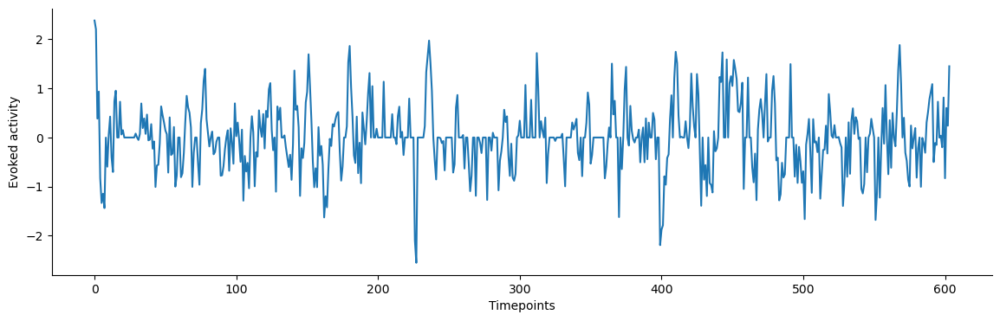

In [411]:
# Nilearn easily calculates the timecourse of activity across all of the ROIs that are supplied to the masker objec
# What does our data structure look like?
print("Parcellated data shape (time points x num ROIs)")
print("All time points  ", bold_ho.shape)

# Pull out a single ROI corresponding to the posterior parahippocampal cortex
# Note that Label #35 is the Parahippocampal Gyrus, posterior division. 
roi_id = 30
bold_ho_pcc = np.array(bold_ho1[:, roi_id])
bold_ho_pcc = bold_ho_pcc.reshape(bold_ho_pcc.shape[0],-1)
print("Posterior PCC (region 34) whole tirals: ", bold_ho_pcc.shape)

plt.figure(figsize=(14,4))
plt.plot(bold_ho_pcc)
plt.ylabel('Evoked activity');
plt.xlabel('Timepoints');
sns.despine()

Parcellated data shape (time points x num ROIs)
All time points   (604, 48)
Posterior Pmc (region 4) whole tirals:  (604, 1)


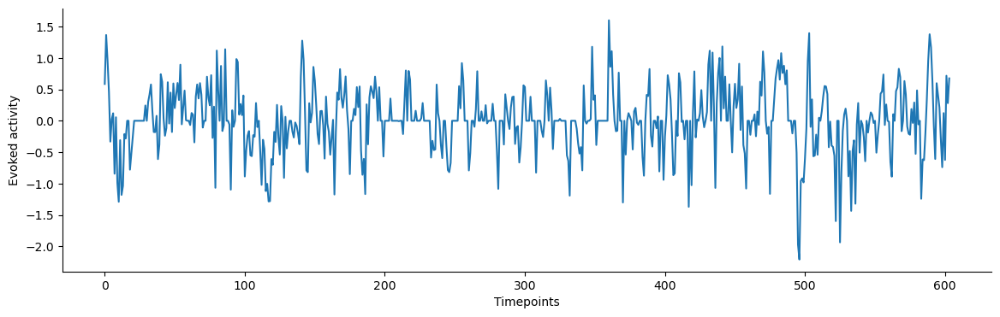

In [410]:
# Nilearn easily calculates the timecourse of activity across all of the ROIs that are supplied to the masker objec
# What does our data structure look like?
print("Parcellated data shape (time points x num ROIs)")
print("All time points  ", bold_ho.shape)

# Pull out a single ROI corresponding to the posterior parahippocampal cortex
# Note that Label #35 is the Parahippocampal Gyrus, posterior division. 
roi_id = 4
bold_ho_pmc = np.array(bold_ho1[:, roi_id])
bold_ho_pmc = bold_ho_pmc.reshape(bold_ho_pmc.shape[0],-1)
print("Posterior Pmc (region 4) whole tirals: ", bold_ho_pmc.shape)

plt.figure(figsize=(14,4))
plt.plot(bold_ho_pmc)
plt.ylabel('Evoked activity');
plt.xlabel('Timepoints');
sns.despine()

PCC correlation Fisher-z transformed: min = -0.416; max = 0.964


Text(0.5, 0, 'Fisher-z score')

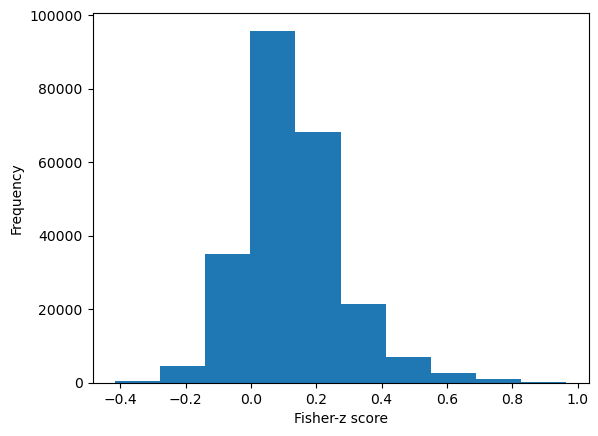

In [412]:
# Like before we want to correlate the whole brain time course with the seed we have pulled out

def seed_correlation(wbBold, seedBold):
    """Compute the correlation between a seed voxel vs. other voxels 
    Parameters
    ----------
    wbBold [2d array], n_stimuli x n_voxels 
    seedBold, 2d array, n_stimuli x 1

    Return
    ----------    
    seed_corr [2d array], n_stimuli x 1
    seed_corr_fishZ [2d array], n_stimuli x 1
    """
    num_voxels = wbBold.shape[1]
    seed_corr = np.zeros((num_voxels, 1))
    for v in range(num_voxels):    
        seed_corr[v, 0] = np.corrcoef(seedBold.flatten(), wbBold[:, v])[0, 1]
    # Transfrom the correlation values to Fisher z-scores    
    seed_corr_fishZ = np.arctanh(seed_corr)
    return seed_corr, seed_corr_fishZ


corr_pcc1, corr_fz_pcc1 = seed_correlation(bold_wb1, bold_ho_pcc) 
corr_pcc2, corr_fz_pcc2 = seed_correlation(bold_wb2, bold_ho_pcc) #ISFC
corr_pcc3, corr_fz_pcc3 = seed_correlation(bold_wb1, bold_ho_pmc) 
corr_pcc4, corr_fz_pcc4 = seed_correlation(bold_wb2, bold_ho_pmc) #ISFC
# Print the range of correlations.
print("PCC correlation Fisher-z transformed: min = %.3f; max = %.3f" % (
    corr_fz_pcc1.min(), corr_fz_pcc1.max()))

# Plot a histogram
plt.hist(corr_fz_pcc1)
plt.ylabel('Frequency');
plt.xlabel('Fisher-z score')

PCC correlation Fisher-z transformed: min = -0.244; max = 0.210


Text(0.5, 0, 'Fisher-z score')

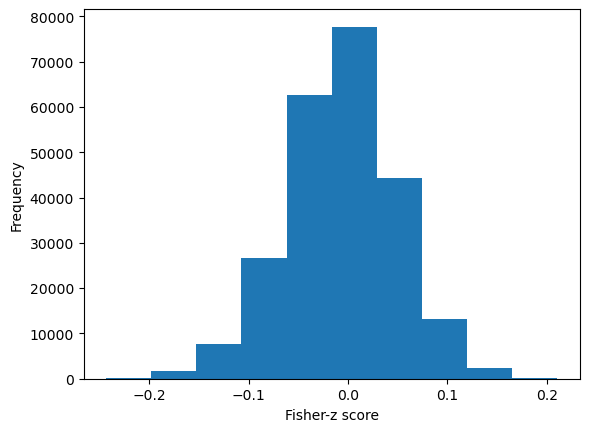

In [313]:
print("PCC correlation Fisher-z transformed: min = %.3f; max = %.3f" % (
    corr_fz_pcc2.min(), corr_fz_pcc2.max()))

# Plot a histogram
plt.hist(corr_fz_pcc2)
plt.ylabel('Frequency');
plt.xlabel('Fisher-z score')

PCC correlation Fisher-z transformed: min = -0.395; max = 0.787


Text(0.5, 0, 'Fisher-z score')

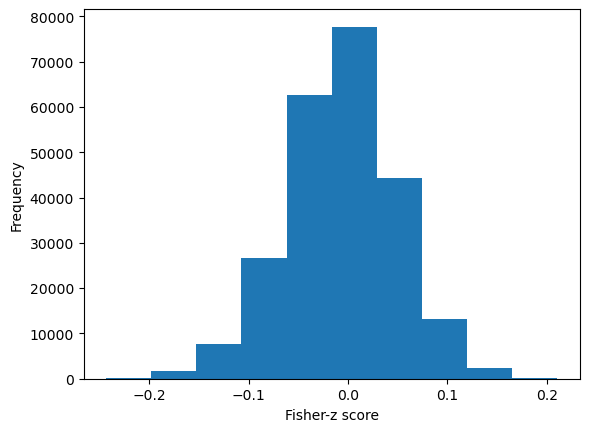

In [413]:
print("PCC correlation Fisher-z transformed: min = %.3f; max = %.3f" % (
    corr_fz_pcc3.min(), corr_fz_pcc3.max()))

# Plot a histogram
plt.hist(corr_fz_pcc2)
plt.ylabel('Frequency');
plt.xlabel('Fisher-z score')

PCC correlation Fisher-z transformed: min = -0.205; max = 0.191


Text(0.5, 0, 'Fisher-z score')

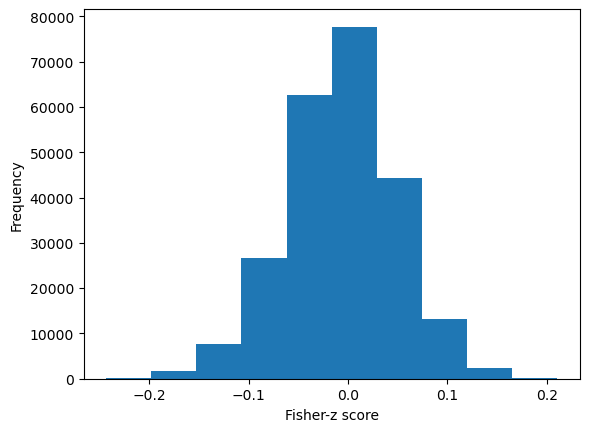

In [414]:
print("PCC correlation Fisher-z transformed: min = %.3f; max = %.3f" % (
    corr_fz_pcc4.min(), corr_fz_pcc4.max()))

# Plot a histogram
plt.hist(corr_fz_pcc2)
plt.ylabel('Frequency');
plt.xlabel('Fisher-z score')

In [322]:
df = pd.DataFrame(corr_fz_pcc2)
df< 0

,0
0,False
1,False
2,False
3,False
4,False
...,...
236680,True
236681,True
236682,True
236683,True


In [415]:
# We can tranform the correlation array back to a Nifti image object that we can save
img_corr_pcc2= masker_wb.inverse_transform(corr_fz_pcc2.T)
img_corr_pmc2= masker_wb.inverse_transform(corr_fz_pcc4.T)

In [304]:
# We can tranform the correlation array back to a Nifti image object that we can save
img_corr_pcc1= masker_wb.inverse_transform(corr_fz_pcc1.T)

TypeError: X must be of shape (samples, 236685).

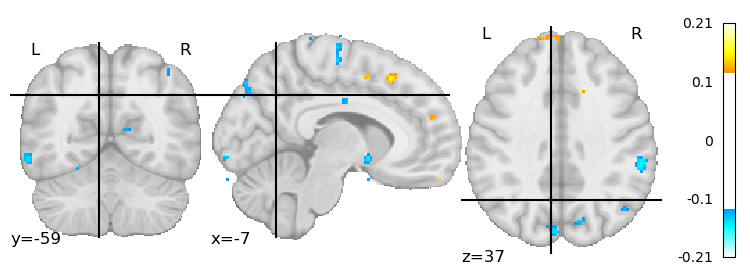

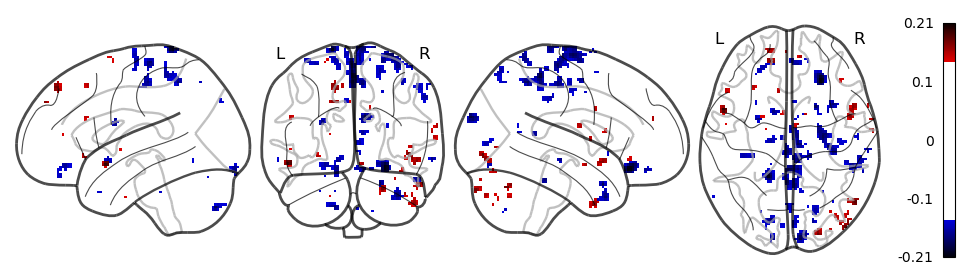

In [422]:
# Map back to the whole brain image
#img_corr_pcc1  =  masker_wb.inverse_transform (corr_fz_pcc1)

threshold = .8 

# Find the cut coordinates of this ROI, using parcellation.
# This function takes the atlas path and the hemisphere and outputs all centers of the ROIs
roi_coords = plotting.find_parcellation_cut_coords(atlas_filename,label_hemisphere='left')

# Pull out the coordinate for this ROI
roi_coord = roi_coords[roi_id,:]

# Plot the correlation as a map on a standard brain. 
# For comparison, we also plot the position of the sphere we created ealier.
h2 = plotting.plot_stat_map(
    img_corr_pmc2, 
    threshold=.12,
    cut_coords=roi_coord,
)

# Create a glass brain
plotting.plot_glass_brain(
    img_corr_pmc2, 
    threshold=.14,
    colorbar=True, 
    plot_abs=False,
    display_mode='lyrz', 
);

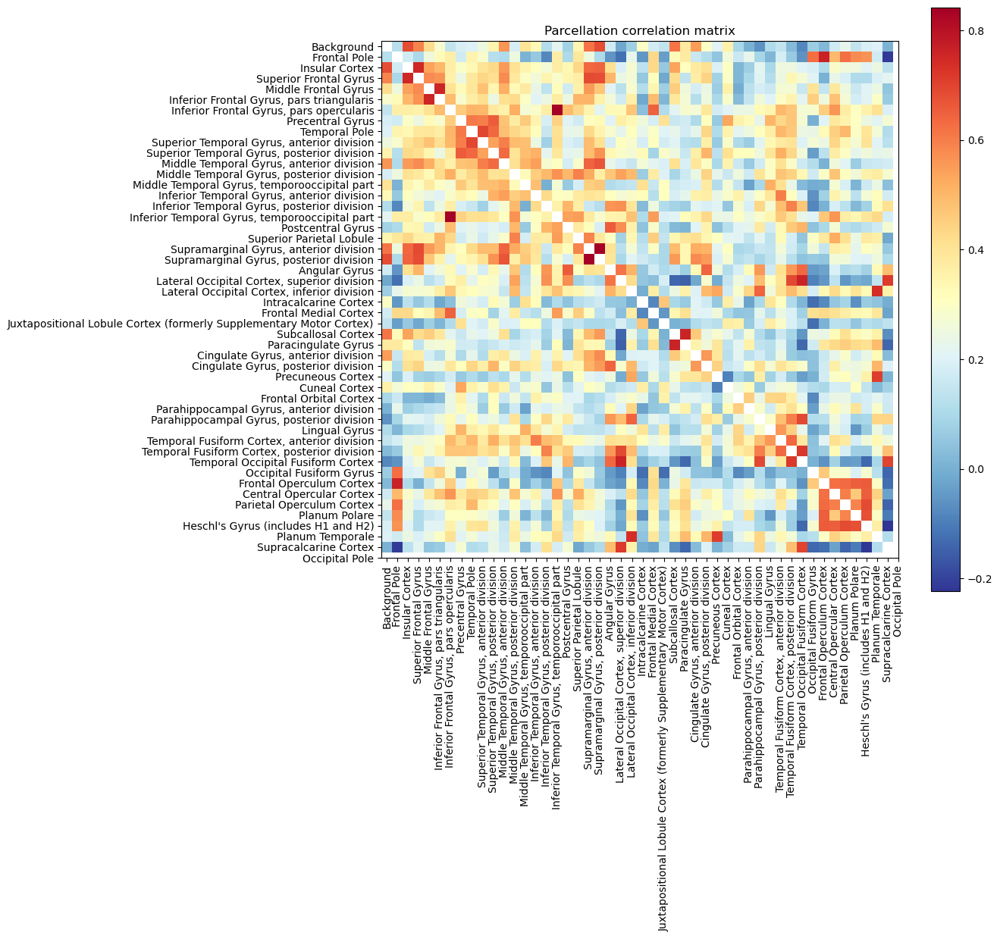

In [317]:
# Compute connectivity across parcels
from nilearn.connectome import ConnectivityMeasure

# Set up the connectivity object
correlation_measure = ConnectivityMeasure(kind='correlation')

# Calculate the correlation of each parcel with every other parcel

corr_mat_ho1 = correlation_measure.fit_transform([bold_ho1])[0]

# Remove the diagonal for visualization (guaranteed to be 1.0)
np.fill_diagonal(corr_mat_ho1, np.nan)

# Plot the correlation matrix
# The labels of the Harvard-Oxford Cortical Atlas that we are using 
# start with the background (0), hence we skip the first label
fig = plt.figure(figsize=(11,10))
plt.imshow(corr_mat_ho1, interpolation='None', cmap='RdYlBu_r')
plt.yticks(range(len(atlas.labels)), atlas.labels[0:]);
plt.xticks(range(len(atlas.labels)), atlas.labels[0:], rotation=90);
plt.title('Parcellation correlation matrix')
plt.colorbar();

In [ ]:
# Alternatively, we could use Nilearn's own plotting function
plotting.plot_matrix(
    corr_mat_ho1, 
    cmap='RdYlBu_r', 
    figure=(11, 10), 
    labels=atlas.labels[1:], 
)

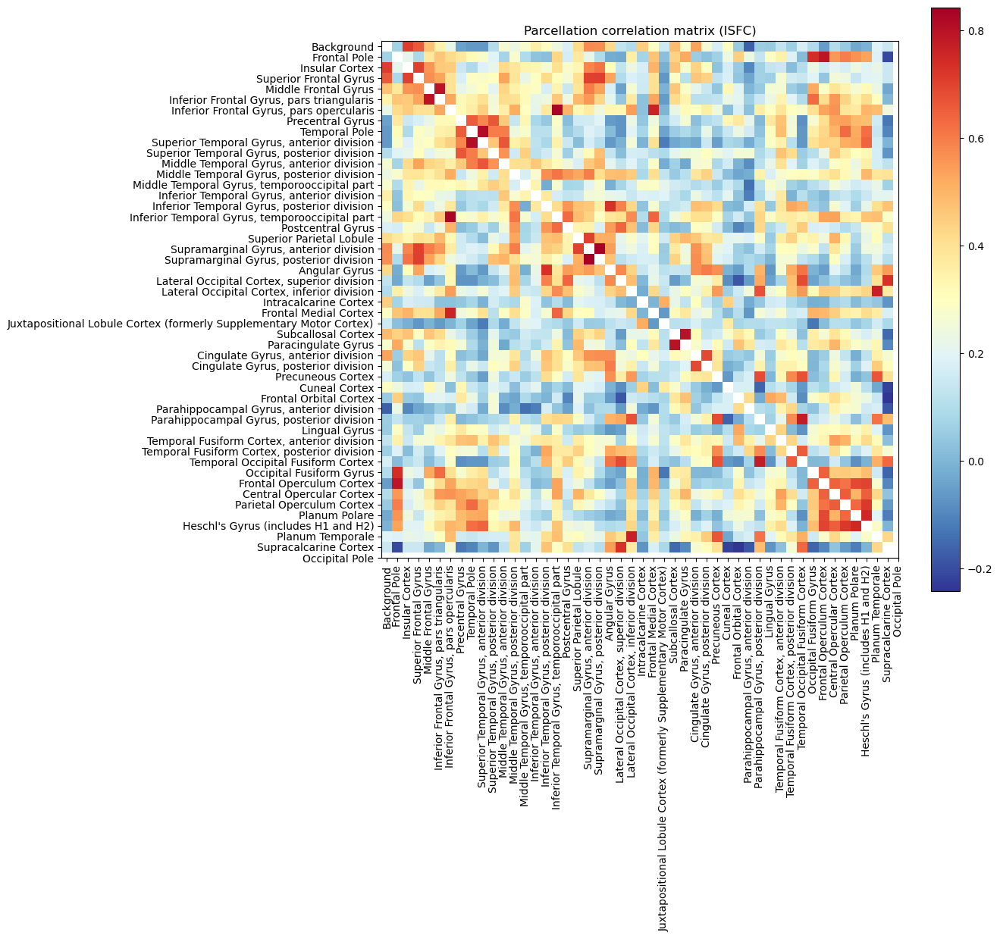

In [318]:
# Compute connectivity across parcels
from nilearn.connectome import ConnectivityMeasure

# Set up the connectivity object
correlation_measure = ConnectivityMeasure(kind='correlation')

# Calculate the correlation of each parcel with every other parcel
corr_mat_ho2 = correlation_measure.fit_transform([bold_ho2])[0]

# Remove the diagonal for visualization (guaranteed to be 1.0)
np.fill_diagonal(corr_mat_ho2, np.nan)

# Plot the correlation matrix
# The labels of the Harvard-Oxford Cortical Atlas that we are using 
# start with the background (0), hence we skip the first label
fig = plt.figure(figsize=(11,10))
plt.imshow(corr_mat_ho2, interpolation='None', cmap='RdYlBu_r')
plt.yticks(range(len(atlas.labels)), atlas.labels[0:]);
plt.xticks(range(len(atlas.labels)), atlas.labels[0:], rotation=90);
plt.title('Parcellation correlation matrix (ISFC)')
plt.colorbar();

#### smith parcellation

In [ ]:
# First we fetch the Yeo atlas
from nilearn import datasets
from nilearn import plotting

# #smith_atlas = datasets.fetch_atlas_smith_2009('smith')
# s_atlas = smith_atlas['rsn70']
# #yeo_atals = datasets.fetch_atlas_yeo_2011('yeo')
# #atlas_networks = smith_atlas.rsn70
# s_atlas_filename = '/home/sincerely/jupyterlab/Movie-encoding/conda_ISC/' + s_atlas



# #havard_oxford atlas

atlas = datasets.fetch_atlas_smith_2009()
atlas_filename = atlas.maps
print(atlas)
# This is where the atlas is saved.
#print("Atlas path: " + f'{atlas_filename}' + "\n\n")

# Plot the ROIs
plotting.plot_roi(atlas_filename);
print('Smith atlas')

In [283]:
s_atlas

'smith/smith_2009/rsn70.nii.gz'

In [279]:
# This is where the atlas is saved.
#print("Atlas path: " + f'{atlas_filename}' + "\n\n")

# Plot the ROIs
plotting.plot_roi(s_atlas);
print('Harvard-Oxford cortical atlas')

# Let's now plot it
from nilearn import plotting

for label in ['thick_7','thick_17']:
  n = label.replace("thick_","")
  atlas = atlas_yeo_2011[label] #this loads in a .nii file
  plotting.plot_roi(atlas, title= f'Yeo - {n} Network',cmap='Paired')

DimensionError: Input data has incompatible dimensionality: Expected dimension is 3D and you provided a 4D image. See https://nilearn.github.io/stable/manipulating_images/input_output.html.

### Trimming the timeSeries

## Inter Subject FC

In [224]:
sub_timeseries2 = {}
sub_timeseries_run1 = {}
sub_timeseries_run2 = {}
subjects = ['05','06']
for sub in subjects:
    run_data1 = pd.read_csv(os.path.join(ROIs_dir, f'sub-{sub}_run-1_Average_ROI_n50.csv'))
    run_data2 = pd.read_csv(os.path.join(ROIs_dir, f'sub-{sub}_run-2_Average_ROI_n50.csv'))
    run_data = run_data1.append(run_data2)
    run_data.reset_index(inplace=True, drop=True)
    run_data1.reset_index(inplace=True, drop=True)
    run_data2.reset_index(inplace=True, drop=True)
    sub_timeseries2[sub] = run_data
    sub_timeseries_run1[sub] = run_data1
    sub_timeseries_run2[sub] = run_data2

Text(101.6444444444445, 0.5, 'ROI')

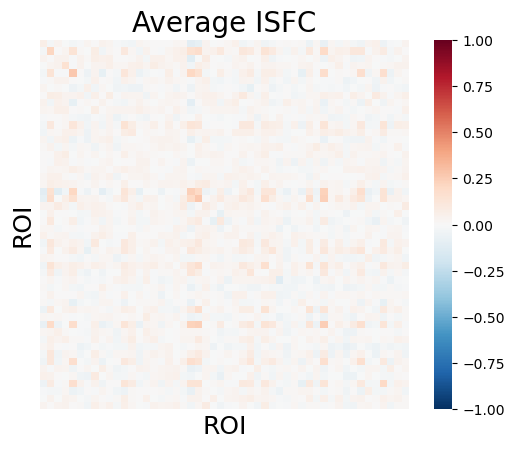

In [230]:
from nltools.stats import isc, isfc, isps, fdr, threshold
import matplotlib.pyplot as plt

data1 = list(sub_timeseries_run1.values())
data2 = list(sub_timeseries_run2.values())
isfc_output1 =  isfc(data1)
isfc_output2 =  isfc(data2)
#isfc_output =  isfc_output2 - isfc_output1
sns.heatmap(np.array(isfc_output1).mean(axis=0), vmin=-1, vmax=1, square=True, cmap='RdBu_r', xticklabels=False, yticklabels=False)
plt.title('Average ISFC', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)

In [222]:
isfc_output1

[array([[ 0.0481134 , -0.03964962, -0.05447079, ...,  0.02271026,
          0.09396922, -0.01793609],
        [-0.06349985,  0.25939112, -0.06370926, ...,  0.04034806,
          0.02621409, -0.0667604 ],
        [-0.04580439, -0.03911302,  0.03312479, ..., -0.02048881,
          0.04873629, -0.03646575],
        ...,
        [ 0.02832809, -0.11952387,  0.02027391, ...,  0.02908628,
          0.03155718, -0.00714836],
        [-0.01542663, -0.1000238 , -0.04215751, ..., -0.10084735,
          0.0401086 ,  0.00708392],
        [-0.10366898,  0.00394805,  0.01331892, ..., -0.08462256,
         -0.03769467,  0.00229876]]),
 array([[-0.00309307, -0.078904  , -0.02649215, ...,  0.01576572,
          0.01214509, -0.13280229],
        [-0.08809716,  0.27067789, -0.0228822 , ..., -0.08727714,
         -0.13925006, -0.01569177],
        [-0.0447994 , -0.14941644, -0.0112265 , ...,  0.02700958,
          0.04661031,  0.02490975],
        ...,
        [-0.04528475,  0.00689653, -0.05596708, ..., -

Text(101.6444444444445, 0.5, 'ROI')

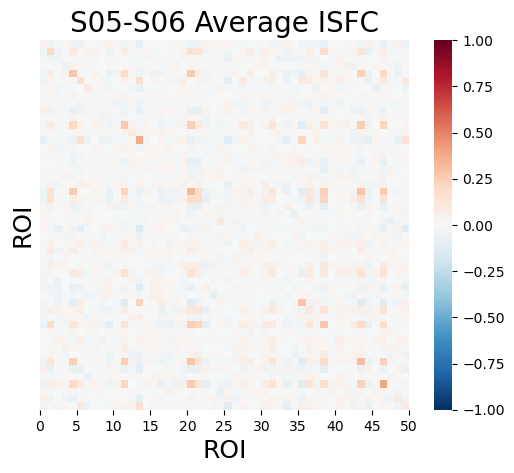

In [90]:
data = list(sub_timeseries2.values()) # S02 의 Run 1과 Run2 각각에서 50 개의 ROI

isfc_output = isfc(data)
x= np.arange(0,51,5) 

sns.heatmap(np.array(isfc_output).mean(axis=0), vmin=-1, vmax=1, square=True, cmap='RdBu_r', xticklabels=False, yticklabels=False)
plt.title('S05-S06 Average ISFC', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.xticks(x,x)
plt.ylabel('ROI', fontsize=18)

In [68]:
isfc_output[0][0].size

50

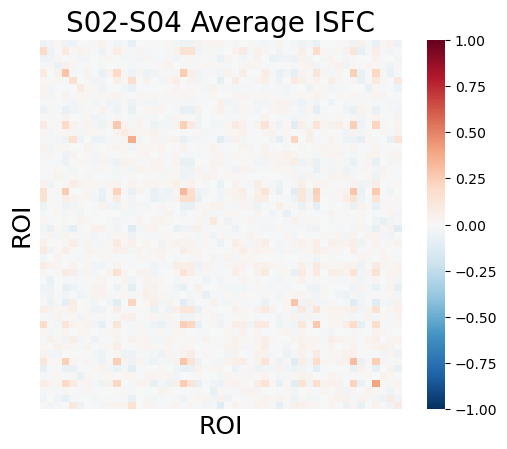

In [86]:
data = list(sub_timeseries2.values()) # S02 의 Run 1과 Run2 각각에서 50 개의 ROI

isfc_output = isfc(data)

sns.heatmap(np.array(isfc_output).mean(axis=0), vmin=-1, vmax=1, square=True, cmap='RdBu_r', xticklabels=False, yticklabels=False)
plt.title('S02-S04 Average ISFC', fontsize=20)
plt.xlabel('ROI', fontsize=18)

plt.ylabel('ROI', fontsize=18)

plt.show()

# Functional Connectivity - Making a DM for describing HPC time course responses

- Build our regression design matrix to perform the whole-brain functional connectivity analysis.
- The goal is to find which regions in the brain have a similar time course to the vmPFC, controlling for all of our covariates (i.e., nuisance regressors).

In [112]:
%matplotlib inline

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltools.data import Brain_Data, Design_Matrix, Adjacency
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import zscore, fdr, one_sample_permutation
from nltools.file_reader import onsets_to_dm
from nltools.plotting import component_viewer
from scipy.stats import binom, ttest_1samp
from sklearn.metrics import pairwise_distances
from copy import deepcopy
#import networkx as nx
from nilearn.plotting import plot_stat_map, view_img_on_surf
#from bids import BIDSLayout, BIDSValidator
import nibabel as nib

#base_dir = '..'
data_dir = '/mnt/c/Users/since/Desktop/KdramaSpring/data/derivatives/'
#layout = BIDSLayout(data_dir, derivatives=True)

In [129]:
data = Brain_Data(glob.glob(os.path.join(data_dir, 'sub-06', 'func', f'sub-06_task-encoding_run-1_space-MNI152NLin6Asym_res-2_desc-preproc_bold.nii.gz'))[0])

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/masking.py:858: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


Text(0.5, 0, 'Time (TRs)')

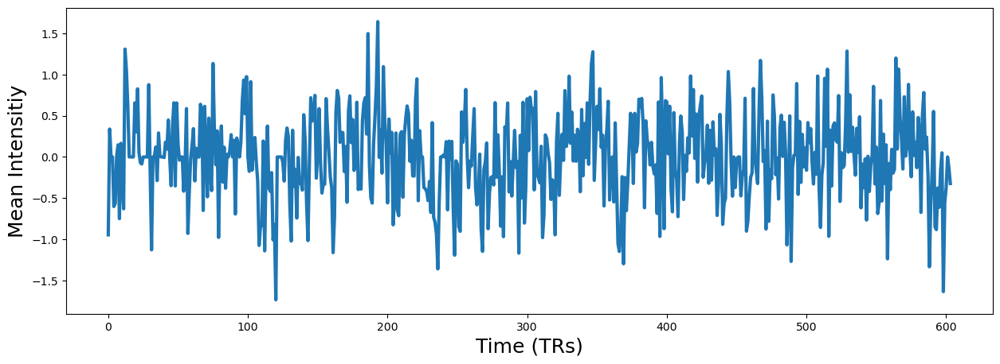

In [127]:
mask_x = expand_mask(mask)
hpc = data.extract_roi(mask=mask_x[28]) # HPC 
plt.figure(figsize=(15,5))
plt.plot(vmpfc, linewidth=3)
plt.ylabel('Mean Intensitiy', fontsize=18)
plt.xlabel('Time (TRs)', fontsize=18)

In [131]:
tr = 1.5
fwhm = 6
n_tr = len(data)

hpc = zscore(pd.DataFrame(hpc, columns=['hpc']))

csf = Brain_Data(glob.glob(os.path.join(data_dir, 'sub-06', 'anat', '*CSF*.nii.gz'))[1])
smoothed = data.smooth(fwhm=fwhm)

spikes = smoothed.find_spikes(global_spike_cutoff=3, diff_spike_cutoff=3) #FD가 2std 초과하는 것들만 Outlier로 만들었다. 
covariates = pd.read_csv(glob.glob(os.path.join(data_dir, 'sub-06', 'func', 'sub-06_task-encoding_run-1_desc-confounds_timeseries.tsv'))[0], sep='\t')

def make_motion_covariates(mc, tr):
    z_mc = zscore(mc)
    all_mc = pd.concat([z_mc, z_mc**2, z_mc.diff(), z_mc.diff()**2], axis=1)
    all_mc.fillna(value=0, inplace=True)
    return Design_Matrix(all_mc, sampling_freq=1/tr)

mc = covariates[['trans_x','trans_y','trans_z','rot_x', 'rot_y', 'rot_z']]
mc_cov = make_motion_covariates(mc, tr)
motionOutliers = covariates.filter(regex='motion_outlier')

csf = zscore(pd.Series(smoothed.extract_roi(csf.threshold(upper=0.85, binarize=True)))) # Use CSF from fmriprep output

dm = Design_Matrix(pd.concat([hpc, csf, mc_cov, motionOutliers, spikes.drop(labels='TR', axis=1)], axis=1), sampling_freq=1/tr)
dm = dm.add_poly(order=2, include_lower=True) # Add Intercept, Linear and Quadratic Trends

smoothed.X = dm
stats = smoothed.regress()

hpc_conn = stats['beta'][0]

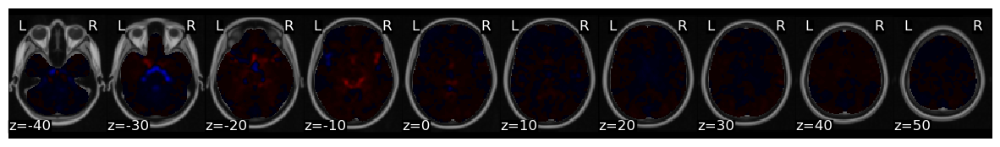

In [134]:
hpc_conn.plot()

## 전체 참|가자들에 대한 FC 분석

In [104]:
file_list = glob.glob(os.path.join(data_dir, f'sub-{s}', 'func', '*preproc*.nii.gz'))
    print(len(file_list))
    for f in file_list:
        sub = os.path.basename(f).split('_')[0]
        task = os.path.basename(f).split('_')[1]
        run = os.path.basename(f).split('_')[2]
           
        # if not os.path.exists(result_dir):
        #     os.makedirs(result_dir)
        csf = Brain_Data(glob.glob(os.path.join(data_dir, f'{sub}', 'anat', '*CSF*.nii.gz'))[1])
        data = Brain_Data(f) #denoise 
        smoothed = data.smooth(fwhm=fwhm)
        
        spikes = smoothed.find_spikes(global_spike_cutoff=outlier_cutoff, diff_spike_cutoff=outlier_cutoff) #FD가 2std 초과하는 것들만 Outlier로 만들었다. 
        covariates = pd.read_csv(glob.glob(os.path.join(data_dir, sub, 'func', f'{sub}_{task}_{run}_desc-confounds_timeseries.tsv'))[0], sep='\t')
        
        mc = covariates[['trans_x','trans_y','trans_z','rot_x', 'rot_y', 'rot_z']]
        mc_cov = make_motion_covariates(mc, tr)
        motionOutliers = covariates.filter(regex='motion_outlier')
        
        csf = zscore(pd.Series(smoothed.extract_roi(csf.threshold(upper=0.85, binarize=True)))) # Use CSF from fmriprep output
        
        dm = Design_Matrix(pd.concat([csf, mc_cov, motionOutliers, spikes.drop(labels='TR', axis=1)], axis=1), sampling_freq=1/tr)
        dm = dm.add_poly(order=2, include_lower=True) # Add Intercept, Linear and Quadratic Trends

        data.X = dm
        stats = data.regress()
        stats['residual'].data = np.float32(stats['residual'].data) # cast as float32 to reduce storage space
        stats['residual'].write(os.path.join(Zdenoised_dir, f'{sub}_denoise_{task}_{run}_space-MNI152NLin6Asym_desc-preproc_bold.nii.gz'))
        print( f'finisih_{sub}_{task}_{run}_data')

['/mnt/c/Users/since/Desktop/KdramaSpring/analysis/denoised_zscore/sub-01_denoise_task-encoding_run-1_space-MNI152NLin6Asym_desc-preproc_bold.nii.gz']